In [1]:
#Import cell
import sympy as sym
import numpy as np
import matplotlib.pyplot as plt
import math

def custom_latex_printer(exp,**options):
    from google.colab.output._publish import javascript
    url = "https://cdnjs.cloudflare.com/ajax/libs/mathjax/3.1.1/latest.js?config=TeX-AMS_HTML"
    javascript(url=url)
    return sym.printing.latex(exp,**options)
sym.init_printing(use_latex="mathjax",latex_printer=custom_latex_printer)


In [2]:
from sympy import *

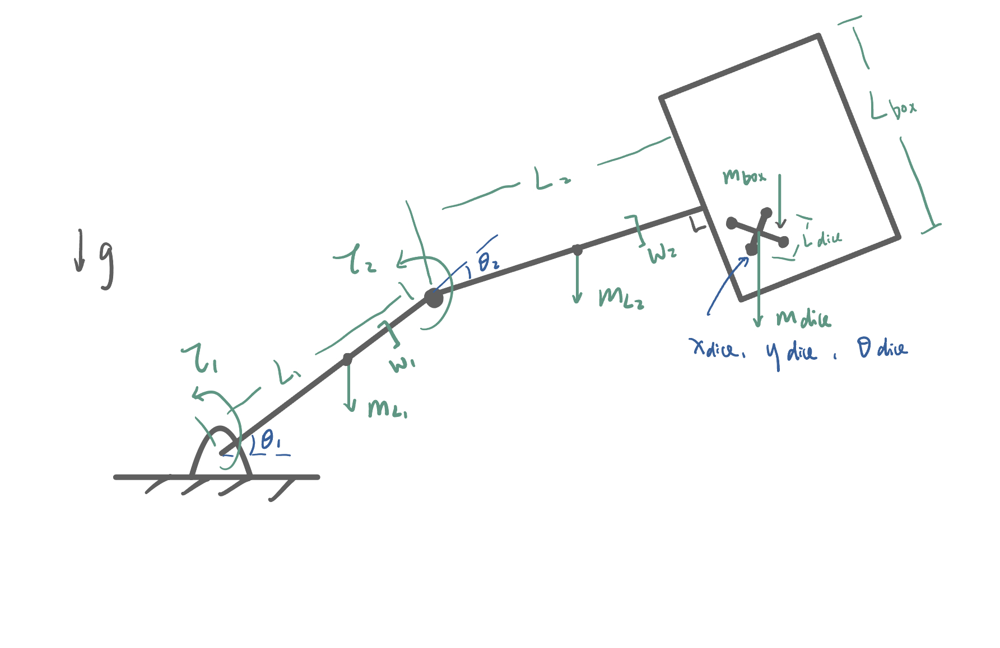

In [3]:
"""
L1: length of link 1
w1: width of link 1
L2: length of link 2
w2: width of link 2
LB: side length of box
LD: side length of dice
mL1: mass of link 1
mL2: mass of link 2
mB: mass of box
mD: mass of dice
"""
L1 = 20
w1 = 2
L2 = 20
w2 = 2
LB = 8
LD = 2
mL1 = 10
mL2 = 10
mB = 50
mD = 10
grav = 9.8

t = symbols("t")
th1 = Function(r"\theta_1")(t)
th2 = Function(r"\theta_2")(t)
xD = Function(r"x_D")(t)
yD = Function(r"y_D")(t)
thD = Function(r"\theta_D")(t)

# External forces
FD = -mD*grav
FB = -mB*grav
Tor1 = 8000
Tor2 = 1000
TB = -L2*mB*grav
F_ext = Matrix([Tor1,Tor2+TB,0,FD,0])

q = Matrix([th1,th2,xD,yD,thD])
qd = diff(q,t)
qdd = diff(qd,t)

In [4]:
def inv(M): # M 4x4
    R = M[:3,:3]# R 3x3
    p = M[:3,-1]# p 3x1
    Rinv = R.T
    pinv = -R.T @ p
    M_inv = Matrix([[Rinv[0,0],Rinv[0,1],Rinv[0,2],pinv[0,0]],
                    [Rinv[1,0],Rinv[1,1],Rinv[1,2],pinv[1,0]],
                    [Rinv[2,0],Rinv[2,1],Rinv[2,2],pinv[2,0]],
                    [0,0,0,1]])
    return M_inv

def unhat(M):
    return Matrix([M[0,3],M[1,3],M[2,3],M[2,1],M[0,2],M[1,0]])

In [5]:
gWA = Matrix([[cos(th1),-sin(th1),0,0],[sin(th1),cos(th1),0,0],[0,0,1,0],[0,0,0,1]])
gAB = Matrix([[1,0,0,L1/2],[0,1,0,0],[0,0,1,0],[0,0,0,1]])
gBC = Matrix([[1,0,0,L1/2],[0,1,0,0],[0,0,1,0],[0,0,0,1]])
gCD = Matrix([[cos(2*pi-th2),-sin(2*pi-th2),0,0],[sin(2*pi-th2),cos(2*pi-th2),0,0],[0,0,1,0],[0,0,0,1]])
gDE = Matrix([[1,0,0,L2/2],[0,1,0,0],[0,0,1,0],[0,0,0,1]])
gEF = Matrix([[1,0,0,L2/2+LB/2],[0,1,0,0],[0,0,1,0],[0,0,0,1]])

gWG = Matrix([[cos(thD),-sin(thD),0,xD],[sin(thD),cos(thD),0,yD],[0,0,1,0],[0,0,0,1]])

gWB = gWA @ gAB
gWC = gWA @ gAB @ gBC
gWE = gWA @ gAB @ gBC @ gCD @ gDE
gWF = gWA @ gAB @ gBC @ gCD @ gDE @ gEF

print("W -> B")
display(gWB)
print("W -> C")
display(gWC)
print("W -> E")
display(gWE)
print("W -> F (box)")
display(gWF)
print("W -> G (dice)")
display(gWG)

W -> B


⎡cos(\theta₁(t))  -sin(\theta₁(t))  0  10.0⋅cos(\theta₁(t))⎤
⎢                                                          ⎥
⎢sin(\theta₁(t))  cos(\theta₁(t))   0  10.0⋅sin(\theta₁(t))⎥
⎢                                                          ⎥
⎢       0                0          1           0          ⎥
⎢                                                          ⎥
⎣       0                0          0           1          ⎦

W -> C


⎡cos(\theta₁(t))  -sin(\theta₁(t))  0  20.0⋅cos(\theta₁(t))⎤
⎢                                                          ⎥
⎢sin(\theta₁(t))  cos(\theta₁(t))   0  20.0⋅sin(\theta₁(t))⎥
⎢                                                          ⎥
⎢       0                0          1           0          ⎥
⎢                                                          ⎥
⎣       0                0          0           1          ⎦

W -> E


⎡sin(\theta₁(t))⋅sin(\theta₂(t)) + cos(\theta₁(t))⋅cos(\theta₂(t))  -sin(\thet
⎢                                                                             
⎢sin(\theta₁(t))⋅cos(\theta₂(t)) - sin(\theta₂(t))⋅cos(\theta₁(t))  sin(\theta
⎢                                                                             
⎢                                0                                            
⎢                                                                             
⎣                                0                                            

a₁(t))⋅cos(\theta₂(t)) + sin(\theta₂(t))⋅cos(\theta₁(t))  0  10.0⋅sin(\theta₁(
                                                                              
₁(t))⋅sin(\theta₂(t)) + cos(\theta₁(t))⋅cos(\theta₂(t))   0  10.0⋅sin(\theta₁(
                                                                              
                      0                                   1                   
                                                   

W -> F (box)


⎡sin(\theta₁(t))⋅sin(\theta₂(t)) + cos(\theta₁(t))⋅cos(\theta₂(t))  -sin(\thet
⎢                                                                             
⎢sin(\theta₁(t))⋅cos(\theta₂(t)) - sin(\theta₂(t))⋅cos(\theta₁(t))  sin(\theta
⎢                                                                             
⎢                                0                                            
⎢                                                                             
⎣                                0                                            

a₁(t))⋅cos(\theta₂(t)) + sin(\theta₂(t))⋅cos(\theta₁(t))  0  24.0⋅sin(\theta₁(
                                                                              
₁(t))⋅sin(\theta₂(t)) + cos(\theta₁(t))⋅cos(\theta₂(t))   0  24.0⋅sin(\theta₁(
                                                                              
                      0                                   1                   
                                                   

W -> G (dice)


⎡cos(\theta_D(t))  -sin(\theta_D(t))  0  x_D(t)⎤
⎢                                              ⎥
⎢sin(\theta_D(t))  cos(\theta_D(t))   0  y_D(t)⎥
⎢                                              ⎥
⎢       0                  0          1    0   ⎥
⎢                                              ⎥
⎣       0                  0          0    1   ⎦

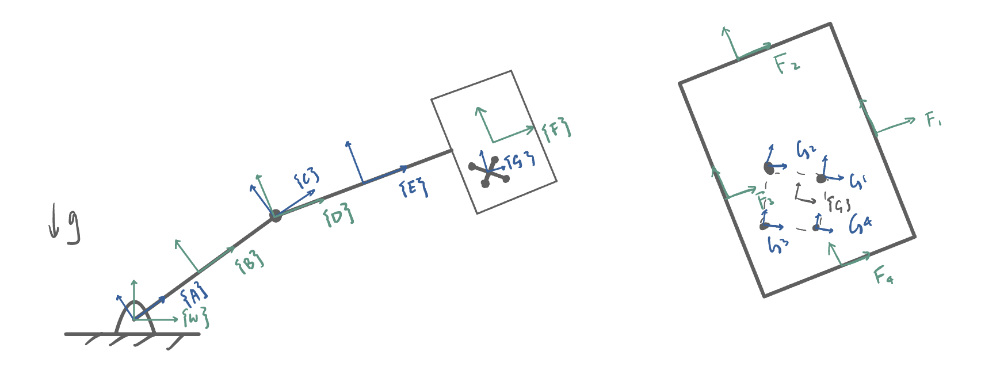

In [6]:
# Dice vertex
gd1 = Matrix([[1,0,0,LD/2],[0,1,0,LD/2],[0,0,1,0],[0,0,0,1]])
gd2 = Matrix([[1,0,0,-LD/2],[0,1,0,LD/2],[0,0,1,0],[0,0,0,1]])
gd3 = Matrix([[1,0,0,-LD/2],[0,1,0,-LD/2],[0,0,1,0],[0,0,0,1]])
gd4 = Matrix([[1,0,0,LD/2],[0,1,0,-LD/2],[0,0,1,0],[0,0,0,1]])

# W to dice
gwd1 = gWG @ gd1
gwd2 = gWG @ gd2
gwd3 = gWG @ gd3
gwd4 = gWG @ gd4

# Box wall midpoint
gb1 = Matrix([[1,0,0,LB/2],[0,1,0,0],[0,0,1,0],[0,0,0,1]])
gb2 = Matrix([[1,0,0,0],[0,1,0,LB/2],[0,0,1,0],[0,0,0,1]])
gb3 = Matrix([[1,0,0,-LB/2],[0,1,0,0],[0,0,1,0],[0,0,0,1]])
gb4 = Matrix([[1,0,0,0],[0,1,0,-LB/2],[0,0,1,0],[0,0,0,1]])

# W to box
gwb1 = gWF @ gb1
gwb2 = gWF @ gb2
gwb3 = gWF @ gb3
gwb4 = gWF @ gb4

# box-dice
gb1d1 = inv(gwb1) @ gwd1
gb1d2 = inv(gwb1) @ gwd2
gb1d3 = inv(gwb1) @ gwd3
gb1d4 = inv(gwb1) @ gwd4

gb2d1 = inv(gwb2) @ gwd1
gb2d2 = inv(gwb2) @ gwd2
gb2d3 = inv(gwb2) @ gwd3
gb2d4 = inv(gwb2) @ gwd4

gb3d1 = inv(gwb3) @ gwd1
gb3d2 = inv(gwb3) @ gwd2
gb3d3 = inv(gwb3) @ gwd3
gb3d4 = inv(gwb3) @ gwd4

gb4d1 = inv(gwb4) @ gwd1
gb4d2 = inv(gwb4) @ gwd2
gb4d3 = inv(gwb4) @ gwd3
gb4d4 = inv(gwb4) @ gwd4

In [7]:
J_box = 1/6*mB*LB**2
J_dice = 1/6*mB*LD**2
J_L1 = 1/6*mL1*L1*w1
J_L2 = 1/6*mL2*L2*w2


I_box = Matrix([[mB,0,0,0,0,0],[0,mB,0,0,0,0],[0,0,mB,0,0,0],[0,0,0,0,0,0],[0,0,0,0,0,0],[0,0,0,0,0,J_box]])
I_dice = Matrix([[mD,0,0,0,0,0],[0,mD,0,0,0,0],[0,0,mD,0,0,0],[0,0,0,0,0,0],[0,0,0,0,0,0],[0,0,0,0,0,J_dice]])
I_L1 = Matrix([[mL1,0,0,0,0,0],[0,mL1,0,0,0,0],[0,0,mL1,0,0,0],[0,0,0,0,0,0],[0,0,0,0,0,0],[0,0,0,0,0,J_L1]])
I_L2 = Matrix([[mL2,0,0,0,0,0],[0,mL2,0,0,0,0],[0,0,mL2,0,0,0],[0,0,0,0,0,0],[0,0,0,0,0,0],[0,0,0,0,0,J_L2]])

# display(I_box)
# display(I_dice)
# display(I_L1)
# display(I_L2)

In [8]:
# Lagrangian
# KE
VelL1 = unhat(inv(gWB) @ diff(gWB,t))
VelL2 = unhat(inv(gWE) @ diff(gWE,t))
VelB = unhat(inv(gWF) @ diff(gWF,t))
VelD = unhat(inv(gWG) @ diff(gWG,t))
KEL1 = 1/2 * VelL1.T @ I_L1 @ VelL1
KEL2 = 1/2 * VelL2.T @ I_L2 @ VelL2
KEB = 1/2 * VelB.T @ I_box @ VelB
KED = 1/2 * VelD.T @ I_dice @ VelD
KE = simplify(KEL1 + KEL2 + KEB + KED)

# V
yL1 = Matrix([0,1,0,0]).T*gWB*Matrix([0,0,0,1])
yL2 = Matrix([0,1,0,0]).T*gWE*Matrix([0,0,0,1])
yB = Matrix([0,1,0,0]).T*gWF*Matrix([0,0,0,1])

V = simplify(grav*(mL1*yL1[0] + mL2*yL2[0] + mB*yB[0] + mD*yD))

L = simplify(KE[0] - V)
print("Lagrangian:")
display(L)

Lagrangian:


                                                                              
                                                                              
-98.0⋅y_D(t) - 12740.0⋅sin(\theta₁(t) - \theta₂(t)) - 12740.0⋅sin(\theta₁(t)) 
                                                                              

                                                        2                     
                          2             ⎛d             ⎞                      
- 1.81898940354586e-12⋅sin (\theta₂(t))⋅⎜──(\theta₁(t))⎟  + 26000.0⋅cos(\theta
                                        ⎝dt            ⎠                      

                      2                                                       
      ⎛d             ⎞                            d              d            
₂(t))⋅⎜──(\theta₁(t))⎟  - 26000.0⋅cos(\theta₂(t))⋅──(\theta₁(t))⋅──(\theta₂(t)
      ⎝dt            ⎠                            dt             dt           

                                     2           

In [9]:
L_mat = Matrix([L])
dLdq = L_mat.jacobian(q)
dLdqd = L_mat.jacobian(qd)
ddtdLdqd = diff(dLdqd,t)
lhs = simplify(ddtdLdqd - dLdq).T
rhs = F_ext
EL = Eq(lhs,rhs)
sol = solve(EL,qdd)
print("EL:")
display(EL)

EL:


⎡                                          2                                  
⎢                          2              d                                   
⎢- 3.63797880709171e-12⋅sin (\theta₂(t))⋅───(\theta₁(t)) - 52000.0⋅sin(\theta₂
⎢                                          2                                  
⎢                                        dt                                   
⎢                                                                             
⎢                                                                             
⎢                                                                             
⎢                                                                             
⎢                                                                             
⎢                                                                             
⎢                                                                             
⎢                                                   

In [10]:
sol_th1dd = sol[qdd[0]]
sol_th2dd = sol[qdd[1]]
sol_xDdd = sol[qdd[2]]
sol_yDdd = sol[qdd[3]]
sol_thDdd = sol[qdd[4]]
var_ls = [*q,*qd,t]
f_th1dd = lambdify(var_ls,sol_th1dd)
f_th2dd = lambdify(var_ls,sol_th2dd)
f_xDdd = lambdify(var_ls,sol_xDdd)
f_yDdd = lambdify(var_ls,sol_yDdd)
f_thDdd = lambdify(var_ls,sol_thDdd)

In [11]:
# Dummy for q and qd
# q = Matrix([th1,th2,xD,yD,thD])
dum_th1 = symbols(r"\theta_d1")
dum_th2 = symbols(r"\theta_d2")
dum_xD = symbols(r"x_dD")
dum_yD = symbols(r"y_dD")
dum_thD = symbols(r"\theta_dD")

dum_th1d = symbols(r"\dot{\theta_{d1}}")
dum_th2d = symbols(r"\dot{\theta_{d2}}")
dum_xDd = symbols(r"\dot{x_{dD}}")
dum_yDd = symbols(r"\dot{y_{dD}}")
dum_thDd = symbols(r"\dot{\theta_{dD}}")

dummy_dict = {
    q[0]:dum_th1,q[1]:dum_th2,q[2]:dum_xD,q[3]:dum_yD,q[4]:dum_thD,
    qd[0]:dum_th1d,qd[1]:dum_th2d,qd[2]:dum_xDd,qd[3]:dum_yDd,qd[4]:dum_thDd
}

# for k in dummy_dict.values():
#     display(k)

In [12]:
# Hamiltonian
H = simplify((dLdqd*qd - L_mat)[0])
print("Hamiltonian")
H_sub = H.subs(dummy_dict)
display(H_sub)

Hamiltonian


                                        2    2                                
- 1.81898940354586e-12⋅\dot{\theta_{d1}} ⋅sin (\theta_d2) + 26000.0⋅\dot{\thet

       2                                                    2                 
a_{d1}} ⋅cos(\theta_d2) + 27733.3333333333⋅\dot{\theta_{d1}}  - 26000.0⋅\dot{\

                                                                              
theta_{d1}}⋅\dot{\theta_{d2}}⋅cos(\theta_d2) - 30400.0⋅\dot{\theta_{d1}}⋅\dot{

                                        2                                     
\theta_{d2}} + 15200.0⋅\dot{\theta_{d2}}  + 16.6666666666667⋅\dot{\theta_{dD}}

2                   2                   2                                     
  + 5.0⋅\dot{x_{dD}}  + 5.0⋅\dot{y_{dD}}  + 98.0⋅y_dD + 12740.0⋅sin(\theta_d1)

                                     
 + 12740.0⋅sin(\theta_d1 - \theta_d2)

In [13]:
# Impact condition (4 verts * 4 walls)
# x of wall 1 & 3 [0,-1]
# y of wall 2 & 4 [1,-1]

# phiBD
phi11 = gb1d1[0,-1].subs(dummy_dict)
phi12 = gb1d2[0,-1].subs(dummy_dict)
phi13 = gb1d3[0,-1].subs(dummy_dict)
phi14 = gb1d4[0,-1].subs(dummy_dict)

phi21 = gb2d1[1,-1].subs(dummy_dict)
phi22 = gb2d2[1,-1].subs(dummy_dict)
phi23 = gb2d3[1,-1].subs(dummy_dict)
phi24 = gb2d4[1,-1].subs(dummy_dict)

phi31 = gb3d1[0,-1].subs(dummy_dict)
phi32 = gb3d2[0,-1].subs(dummy_dict)
phi33 = gb3d3[0,-1].subs(dummy_dict)
phi34 = gb3d4[0,-1].subs(dummy_dict)

phi41 = gb4d1[1,-1].subs(dummy_dict)
phi42 = gb4d2[1,-1].subs(dummy_dict)
phi43 = gb4d3[1,-1].subs(dummy_dict)
phi44 = gb4d4[1,-1].subs(dummy_dict)


phi = Matrix([phi11,phi12,phi13,phi14,phi21,phi22,phi23,phi24,phi31,phi32,phi33,phi34,phi41,phi42,phi43,phi44])
# phi = Matrix([phi11,phi21,phi31,phi41,phi12,phi22,phi32,phi42,phi13,phi23,phi33,phi43,phi14,phi24,phi34,phi44])

In [14]:
# Impact update equation
dLdqd_sub = dLdqd.subs(dummy_dict)
dphidq = phi.jacobian([dum_th1,dum_th2,dum_xD,dum_yD,dum_thD])
lam = symbols("\lambda")
dum_th1dp = symbols(r"\dot{\theta_{d1}^{+}}")
dum_th2dp = symbols(r"\dot{\theta_{d2}^{+}}")
dum_xDdp = symbols(r"\dot{x_{dD}^{+}}")
dum_yDdp = symbols(r"\dot{y_{dD}^{+}}")
dum_thDdp = symbols(r"\dot{\theta_{dD}^{+}}")

impact_dict = {dum_th1d:dum_th1dp,
               dum_th2d:dum_th2dp,
               dum_xDd:dum_xDdp,
               dum_yDd:dum_yDdp,
               dum_thDd:dum_thDdp}

# at t+
lam = symbols(r"\lambda")
dLdqd_p = dLdqd_sub.subs(impact_dict)
dphidq_p = dphidq.subs(impact_dict)
H_p = H_sub.subs(impact_dict)

momt = simplify(dLdqd_p - dLdqd_sub)
lhs = Matrix([momt[0],momt[1],momt[2],momt[3],momt[4],simplify(H_p - H_sub)])

display(lhs)

⎡                                                                             
⎢                                                                             
⎢                                                                             
⎢                                                                             
⎢                                                                             
⎢                                                                             
⎢                                                                             
⎢                                                                             
⎢                                                                             
⎢                                                                             
⎢                                                                             
⎢                                             2    2                          
⎣- 1.81898940354586e-12⋅\dot{\theta_{d1}__{+}} ⋅sin 

In [15]:
# lhs.shape
# dphidq.shape
# 0-4: momemtum; 5: hamiltonian

impact_eqs = []
for i in range(phi.shape[0]):
    p1 = lam*dphidq[i,0]
    p2 = lam*dphidq[i,1]
    p3 = lam*dphidq[i,2]
    p4 = lam*dphidq[i,3]
    p5 = lam*dphidq[i,4]
    rhs = Matrix([p1,p2,p3,p4,p5,0])
    impact_eqs.append(Eq(lhs,rhs))

f_phi = lambdify(list(dummy_dict.values()),phi) #phi shape: 16x1

In [16]:
#Impact!

def impact_cond(s,f_phi,thres):
    val = f_phi(*s)
    for i in range(val.shape[0]):
        if abs(val[i][0]) < thres:
            return (True,i,val)
    return (False,None,val)

# def impact_cond(s,f_phi,prev):
#     val = f_phi(*s)
#     product = val*prev
#     print(product)
#     for i in range(val.shape[0]):
#         if product[i] < 0:
#             return (True,i,val)
#     return (False,None,val)


subs_ls = list(impact_dict.values())
def impact_update(s,impact_eqs,subs_ls):
    sub_d = {dum_th1:s[0],dum_th2:s[1],dum_xD:s[2],dum_yD:s[3],dum_thD:s[4],dum_th1d:s[5],dum_th2d:s[6],dum_xDd:s[7],dum_yDd:s[8],dum_thDd:s[9]}
    update = impact_eqs.subs(sub_d)
    sol_var = [dum_th1dp,dum_th2dp,dum_xDdp,dum_yDdp,dum_thDdp,lam]
    sol_imp = solve(update,sol_var,dict = True)
    if len(sol_imp) == 1:
        print("ERROR!")
    else:
        for sol in sol_imp:
            sol_lam = sol[lam]
            #if not math.isclose(abs(sol_lam),0,abs_tol = 1e-6):
            if abs(sol_lam) > 1e-09:
                sol0 = float(N(sol[subs_ls[0]]))
                sol1 = float(N(sol[subs_ls[1]]))
                sol2 = float(N(sol[subs_ls[2]]))
                sol3 = float(N(sol[subs_ls[3]]))
                sol4 = float(N(sol[subs_ls[4]]))
                res = np.array([s[0],s[1],s[2],s[3],s[4],sol0,sol1,sol2,sol3,sol4])
                return res

In [17]:
# Simulate
def dyn(s,ts):
    # print(s)
    func_th1dd = f_th1dd(*s,ts)
    func_th2dd = f_th2dd(*s,ts)
    func_xDdd = f_xDdd(*s,ts)
    func_yDdd = f_yDdd(*s,ts)
    func_thDdd = f_thDdd(*s,ts)
    return np.array([s[-5],s[-4],s[-3],s[-2],s[-1],func_th1dd,func_th2dd,func_xDdd,func_yDdd,func_thDdd])

def integrate(f, ts, xt, dt):
    k1 = dt * f(xt,ts)
    k2 = dt * f(xt+k1/2.,ts+dt/2.)
    k3 = dt * f(xt+k2/2.,ts+dt/2.)
    k4 = dt * f(xt+k3,ts+dt/2.)
    new_xt = xt + (1/6.) * (k1+2.0*k2+2.0*k3+k4)
    return new_xt

def impact_simulate(f, x0, tspan, dt, integrate):
    n = 0
    N = int((max(tspan)-min(tspan))/dt)
    x = np.copy(x0)
    tvec = np.linspace(min(tspan),max(tspan),N)
    xtraj = np.zeros((len(x0),N))
    ts = 0
    threshold = .1
    for i in range(N):
        ts += dt
        impact = impact_cond(x,f_phi,threshold)[0]
        loc = impact_cond(x,f_phi,threshold)[1]
        phi_val = impact_cond(x,f_phi,threshold)[2]
        if impact:
            x = impact_update(x,impact_eqs[loc],subs_ls)
            # print(loc)
            # print(ts)
            xtraj[:,i]=integrate(f,ts,x,dt)
            n += 1
        else:
            xtraj[:,i]=integrate(f,ts,x,dt)
        x = np.copy(xtraj[:,i])
    print(f"number of impacts: {n}")
    return xtraj

In [18]:
s0 = np.array([np.pi/4,0,30,30,0,0,0,0,0,0])
traj = impact_simulate(dyn,s0,[0,8],.002,integrate)

number of impacts: 103


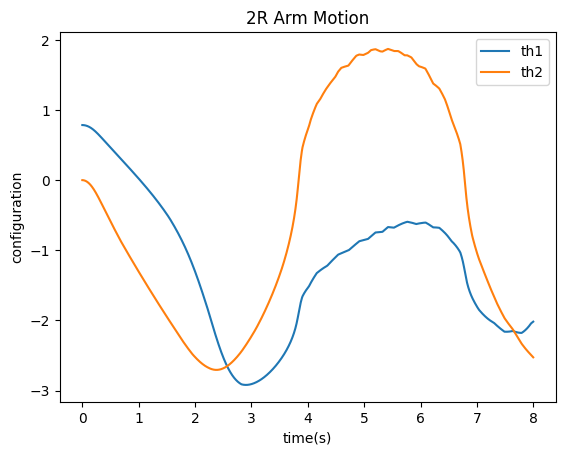

In [19]:
timespan = np.linspace(0,8,4000)
plt.plot(timespan,traj[0])
plt.plot(timespan,traj[1])
plt.xlabel("time(s)")
plt.ylabel("configuration")
plt.title("2R Arm Motion")
plt.legend(["th1","th2"])

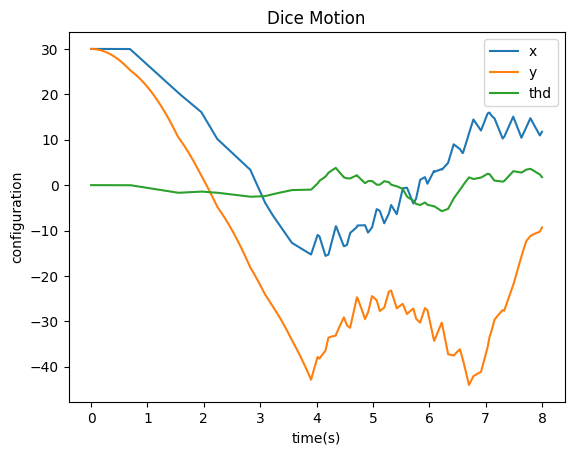

In [20]:
plt.plot(timespan,traj[2])
plt.plot(timespan,traj[3])
plt.plot(timespan,traj[4])
plt.xlabel("time(s)")
plt.ylabel("configuration")
plt.title("Dice Motion")
plt.legend(["x","y","thd"])

In [21]:
def animate_2R(arr,L1,L2,W1,W2,LB,LD,T):

    ################################
    # Imports required for animation.
    from plotly.offline import init_notebook_mode, iplot
    from IPython.display import display, HTML
    import plotly.graph_objects as go

    #######################
    # Browser configuration.
    def configure_plotly_browser_state():
        import IPython
        display(IPython.core.display.HTML('''
            <script src="/static/components/requirejs/require.js"></script>
            <script>
              requirejs.config({
                paths: {
                  base: '/static/base',
                  plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
                },
              });
            </script>
            '''))
    configure_plotly_browser_state()
    init_notebook_mode(connected=False)

    ###############################################
    # Getting data from pendulum angle trajectories.
    tth1 = arr[0]
    tth2 = arr[1]
    xxD = arr[2]
    yyD = arr[3]
    tthD = arr[4]

    N = len(arr[0]) # Need this for specifying length of simulation

    # Box Vertices
    vertB1 = np.array([LB/2,LB/2,0,1])
    vertB2 = np.array([-LB/2,LB/2,0,1])
    vertB3 = np.array([-LB/2,-LB/2,0,1])
    vertB4 = np.array([LB/2,-LB/2,0,1])

    # Dice Vertices
    vertD1 = np.array([LD/2,LD/2,0,1])
    vertD2 = np.array([-LD/2,LD/2,0,1])
    vertD3 = np.array([-LD/2,-LD/2,0,1])
    vertD4 = np.array([LD/2,-LD/2,0,1])

    # Link1 Vertices
    vertL11 = np.array([L1/2,W1/2,0,1])
    vertL12 = np.array([-L1/2,W1/2,0,1])
    vertL13 = np.array([-L1/2,-W1/2,0,1])
    vertL14 = np.array([L1/2,-W1/2,0,1])

    # Link2 Vertices
    vertL21 = np.array([L2/2,W2/2,0,1])
    vertL22 = np.array([-L2/2,W2/2,0,1])
    vertL23 = np.array([-L2/2,-W2/2,0,1])
    vertL24 = np.array([L2/2,-W2/2,0,1])

    ###############################################
    # Define arrays containing data for frame axes
    # In each frame, the x and y axis are always fixed
    x_axis = np.array([0.3, 0.0])
    y_axis = np.array([0.0, 0.3])

    # Use homogeneous tranformation to transfer these two axes/points
    # back to the fixed frame
    frame_b_1_axis = np.zeros((2,N))
    frame_b_2_axis = np.zeros((2,N))
    frame_b_3_axis = np.zeros((2,N))
    frame_b_4_axis = np.zeros((2,N))
    frame_d_1_axis = np.zeros((2,N))
    frame_d_2_axis = np.zeros((2,N))
    frame_d_3_axis = np.zeros((2,N))
    frame_d_4_axis = np.zeros((2,N))
    frame_l1_1_axis = np.zeros((2,N))
    frame_l1_2_axis = np.zeros((2,N))
    frame_l1_3_axis = np.zeros((2,N))
    frame_l1_4_axis = np.zeros((2,N))
    frame_l2_1_axis = np.zeros((2,N))
    frame_l2_2_axis = np.zeros((2,N))
    frame_l2_3_axis = np.zeros((2,N))
    frame_l2_4_axis = np.zeros((2,N))

    for i in range(N): # iteration through each time step
        # evaluate homogeneous transformation
        tWA = np.array([[np.cos(tth1[i]),-np.sin(tth1[i]),0,0],[np.sin(tth1[i]),np.cos(tth1[i]),0,0],[0,0,1,0],[0,0,0,1]])
        tAB = np.array([[1,0,0,L1/2],[0,1,0,0],[0,0,1,0],[0,0,0,1]])
        tBC = np.array([[1,0,0,L1/2],[0,1,0,0],[0,0,1,0],[0,0,0,1]])
        tCD = np.array([[np.cos(2*np.pi-tth2[i]),-np.sin(2*np.pi-tth2[i]),0,0],[np.sin(2*np.pi-tth2[i]),np.cos(2*np.pi-tth2[i]),0,0],[0,0,1,0],[0,0,0,1]])
        tDE = np.array([[1,0,0,L2/2],[0,1,0,0],[0,0,1,0],[0,0,0,1]])
        tEF = np.array([[1,0,0,L2/2+LB/2],[0,1,0,0],[0,0,1,0],[0,0,0,1]])

        tWB = tWA.dot(tAB)
        tWE = tWA.dot(tAB.dot(tBC.dot(tCD.dot(tDE))))
        tWF = tWA.dot(tAB.dot(tBC.dot(tCD.dot(tDE.dot(tEF)))))
        tWG = np.array([[np.cos(tthD[i]),-np.sin(tthD[i]),0,xxD[i]],[np.sin(tthD[i]),np.cos(tthD[i]),0,yyD[i]],[0,0,1,0],[0,0,0,1]])

        # transfer the x and y axes in body frame back to fixed frame at
        # the current time step
        frame_b_1_axis[:,i] = tWF.dot(np.array([vertB1[0],vertB1[1],0,1]))[0:2]
        frame_b_2_axis[:,i] = tWF.dot(np.array([vertB2[0],vertB2[1],0,1]))[0:2]
        frame_b_3_axis[:,i] = tWF.dot(np.array([vertB3[0],vertB3[1],0,1]))[0:2]
        frame_b_4_axis[:,i] = tWF.dot(np.array([vertB4[0],vertB4[1],0,1]))[0:2]

        frame_d_1_axis[:,i] = tWG.dot(np.array([vertD1[0],vertD1[1],0,1]))[0:2]
        frame_d_2_axis[:,i] = tWG.dot(np.array([vertD2[0],vertD2[1],0,1]))[0:2]
        frame_d_3_axis[:,i] = tWG.dot(np.array([vertD3[0],vertD3[1],0,1]))[0:2]
        frame_d_4_axis[:,i] = tWG.dot(np.array([vertD4[0],vertD4[1],0,1]))[0:2]

        frame_l1_1_axis[:,i] = tWB.dot(np.array([vertL11[0],vertL11[1],0,1]))[0:2]
        frame_l1_2_axis[:,i] = tWB.dot(np.array([vertL12[0],vertL12[1],0,1]))[0:2]
        frame_l1_3_axis[:,i] = tWB.dot(np.array([vertL13[0],vertL13[1],0,1]))[0:2]
        frame_l1_4_axis[:,i] = tWB.dot(np.array([vertL14[0],vertL14[1],0,1]))[0:2]

        frame_l2_1_axis[:,i] = tWE.dot(np.array([vertL21[0],vertL21[1],0,1]))[0:2]
        frame_l2_2_axis[:,i] = tWE.dot(np.array([vertL22[0],vertL22[1],0,1]))[0:2]
        frame_l2_3_axis[:,i] = tWE.dot(np.array([vertL23[0],vertL23[1],0,1]))[0:2]
        frame_l2_4_axis[:,i] = tWE.dot(np.array([vertL24[0],vertL24[1],0,1]))[0:2]

    ####################################
    # Using these to specify axis limits.
    xm = -50 #np.min(xx1)-0.5
    xM = 50 #np.max(xx1)+0.5
    ym = -50 #np.min(yy1)-2.5
    yM = 50 #np.max(yy1)+1.5

    ###########################
    # Defining data dictionary.
    # Trajectories are here.
    data=[
        # note that except for the trajectory (which you don't need this time),
        # you don't need to define entries other than "name". The items defined
        # in this list will be related to the items defined in the "frames" list
        # later in the same order. Therefore, these entries can be considered as
        # labels for the components in each animation frame
        dict(name='Dice'),
        dict(name='Dice Vertex'),
        dict(name='Box'),
        dict(name='Link 1'),
        dict(name='Link 2'),
        ]

    ################################
    # Preparing simulation layout.
    # Title and axis ranges are here.
    layout=dict(autosize=False, width=1000, height=1000,
                xaxis=dict(range=[xm, xM], autorange=False, zeroline=False,dtick=1),
                yaxis=dict(range=[ym, yM], autorange=False, zeroline=False,scaleanchor = "x",dtick=1),
                title='2R Simulation',
                hovermode='closest',
                updatemenus= [{'type': 'buttons',
                               'buttons': [{'label': 'Play','method': 'animate',
                                            'args': [None, {'frame': {'duration': T, 'redraw': False}}]},
                                           {'args': [[None], {'frame': {'duration': T, 'redraw': False}, 'mode': 'immediate',
                                            'transition': {'duration': 0}}],'label': 'Pause','method': 'animate'}
                                          ]
                              }]
               )

    ########################################
    # Defining the frames of the simulation.
    # This is what draws the lines from
    # joint to joint of the pendulum.
    frames=[dict(data=[# first three objects correspond to the arms and two masses,
                       # same order as in the "data" variable defined above (thus
                       # they will be labeled in the same order)
                    #    dict(x=[-1,1],
                    #         y=[0,0],
                    #         mode='lines',
                    #         line=dict(color='orange', width=3),
                    #         ),

                       dict(x=[frame_d_1_axis[0][k],frame_d_2_axis[0][k],frame_d_3_axis[0][k],frame_d_4_axis[0][k],frame_d_1_axis[0][k]],
                            y=[frame_d_1_axis[1][k],frame_d_2_axis[1][k],frame_d_3_axis[1][k],frame_d_4_axis[1][k],frame_d_1_axis[1][k]],
                            mode='lines',
                            line=dict(color='orange', width=3),
                            ),
                       go.Scatter(
                            x=[frame_d_1_axis[0][k],frame_d_2_axis[0][k],frame_d_3_axis[0][k],frame_d_4_axis[0][k],frame_d_1_axis[0][k]],
                            y=[frame_d_1_axis[1][k],frame_d_2_axis[1][k],frame_d_3_axis[1][k],frame_d_4_axis[1][k],frame_d_1_axis[1][k]],
                            mode="markers",
                            marker=dict(color="red", size=3)),
                       dict(x=[frame_b_1_axis[0][k],frame_b_2_axis[0][k],frame_b_3_axis[0][k],frame_b_4_axis[0][k],frame_b_1_axis[0][k]],
                            y=[frame_b_1_axis[1][k],frame_b_2_axis[1][k],frame_b_3_axis[1][k],frame_b_4_axis[1][k],frame_b_1_axis[1][k]],
                            mode='lines',
                            line=dict(color='green', width=3),
                            ),
                       dict(x=[frame_l1_1_axis[0][k],frame_l1_2_axis[0][k],frame_l1_3_axis[0][k],frame_l1_4_axis[0][k],frame_l1_1_axis[0][k]],
                            y=[frame_l1_1_axis[1][k],frame_l1_2_axis[1][k],frame_l1_3_axis[1][k],frame_l1_4_axis[1][k],frame_l1_1_axis[1][k]],
                            mode='lines',
                            line=dict(color='blue', width=3),
                            ),
                       dict(x=[frame_l2_1_axis[0][k],frame_l2_2_axis[0][k],frame_l2_3_axis[0][k],frame_l2_4_axis[0][k],frame_l2_1_axis[0][k]],
                            y=[frame_l2_1_axis[1][k],frame_l2_2_axis[1][k],frame_l2_3_axis[1][k],frame_l2_4_axis[1][k],frame_l2_1_axis[1][k]],
                            mode='lines',
                            line=dict(color='blue', width=3),
                            ),

                      ]) for k in range(N)]

    #######################################
    # Putting it all together and plotting.
    figure1=dict(data=data, layout=layout, frames=frames)
    iplot(figure1)

In [24]:
animate_2R(traj,L1,L2,w1,w2,LB,LD,8)